In [1]:
import sys
sys.path.append("..")

import os.path as p
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

from fe.seq import SeqFeBase
from fe.agg import AggFeBase

In [2]:
train_data = pd.read_csv("../../input/data/train_dataset/train_data.csv") 
test_data = pd.read_csv("../../input/data/train_dataset/test_data.csv")

In [3]:
train_data

,userID,assessmentItemID,testId,answerCode,Timestamp,KnowledgeTag
0,0,A060001001,A060000001,1,2020-03-24 00:17:11,7224
1,0,A060001002,A060000001,1,2020-03-24 00:17:14,7225
2,0,A060001003,A060000001,1,2020-03-24 00:17:22,7225
3,0,A060001004,A060000001,1,2020-03-24 00:17:29,7225
4,0,A060001005,A060000001,1,2020-03-24 00:17:36,7225
...,...,...,...,...,...,...
2266581,7441,A030071005,A030000071,0,2020-06-05 06:50:21,438
2266582,7441,A040165001,A040000165,1,2020-08-21 01:06:39,8836
2266583,7441,A040165002,A040000165,1,2020-08-21 01:06:50,8836
2266584,7441,A040165003,A040000165,1,2020-08-21 01:07:36,8836


In [4]:
train_data.groupby("KnowledgeTag").size().mean()

2485.2916666666665

In [5]:
train_data.groupby(["userID", "KnowledgeTag"]).size().mean()

5.141959428496241

In [6]:
test_data.groupby(["userID", "KnowledgeTag"]).size().mean()

5.045662631905649

In [7]:
import torch

In [9]:
torch.sigmoid(torch.tensor(1.0)), torch.sigmoid(torch.tensor(0.))

(tensor(0.7311), tensor(0.5000))

In [10]:
test_data

,userID,assessmentItemID,testId,answerCode,Timestamp,KnowledgeTag
0,3,A050023001,A050000023,1,2020-01-09 10:56:31,2626
1,3,A050023002,A050000023,1,2020-01-09 10:56:57,2626
2,3,A050023003,A050000023,0,2020-01-09 10:58:31,2625
3,3,A050023004,A050000023,0,2020-01-09 10:58:36,2625
4,3,A050023006,A050000023,0,2020-01-09 10:58:43,2623
...,...,...,...,...,...,...
260109,7439,A040130001,A040000130,0,2020-10-14 23:07:23,8832
260110,7439,A040130002,A040000130,1,2020-10-14 23:07:41,8832
260111,7439,A040130003,A040000130,1,2020-10-14 23:08:02,8244
260112,7439,A040130004,A040000130,1,2020-10-14 23:09:31,8244


### 유저, 시험지로 GroupBy 하고 mqx_seq_len 으로 짤랐을 때 분포

In [11]:
from collections import defaultdict
ti_counter = defaultdict(int)
fi_counter = defaultdict(int)
kn_counter = defaultdict(int)

for g in test_data.groupby(["userID", "testId"]):
    if g[1].answerCode.iloc[-1] == -1:
        tn = g[1].iloc[-20:].testId.nunique()
        kn = g[1].iloc[-20:].KnowledgeTag.nunique()
        fn = g[1].iloc[-20:].testId.apply(lambda x: x[2:3]).nunique()
            
        ti_counter[tn] += 1
        kn_counter[kn] += 1
        fi_counter[fn] += 1

In [12]:
ti_counter, kn_counter, fi_counter

(defaultdict(int, {1: 744}),
 defaultdict(int, {2: 170, 3: 87, 1: 378, 6: 14, 4: 58, 5: 9, 7: 24, 8: 4}),
 defaultdict(int, {1: 744}))

### 유저로 GroupBy 하고 max_seq_len으로 짤랐을 때 분포

In [13]:
from collections import defaultdict
ti_counter = defaultdict(int)
fi_counter = defaultdict(int)
kn_counter = defaultdict(int)

for g in test_data.groupby("userID"):
    if g[1].answerCode.iloc[-1] == -1:
        tn = g[1].iloc[-20:].testId.nunique()
        kn = g[1].iloc[-20:].KnowledgeTag.nunique()
        fn = g[1].iloc[-20:].testId.apply(lambda x: x[2:3]).nunique()
            
        ti_counter[tn] += 1
        kn_counter[kn] += 1
        fi_counter[fn] += 1

In [14]:
ti_counter, kn_counter, fi_counter

(defaultdict(int, {3: 331, 4: 382, 2: 3, 5: 28}),
 defaultdict(int,
             {7: 96,
              8: 69,
              4: 176,
              3: 40,
              5: 158,
              11: 9,
              2: 9,
              9: 23,
              6: 134,
              10: 19,
              12: 6,
              13: 3,
              14: 1,
              15: 1}),
 defaultdict(int, {1: 370, 2: 297, 3: 77}))

이렇게 될 경우... 더 어려운 문제이고 복잡한 패턴을 발견해야 되는 문제로 바뀐다.

In [15]:
tn_per = dict(test_data[test_data.answerCode != -1].groupby(["userID", "testId"]).answerCode.mean())

In [16]:
kn_per = dict(test_data[test_data.answerCode != -1].groupby(["userID","KnowledgeTag"]).answerCode.mean())

In [17]:
kn_per[(2988, 7862)]

0.6666666666666666

In [18]:
pred = []
cnt = 0

for row in test_data[test_data.answerCode == -1].iterrows():
    try:
        pred.append(kn_per[row[1].userID, row[1].KnowledgeTag])
    except:
        pred.append(tn_per[row[1].userID, row[1].testId])
        print(pred[-1], end="  ")

0.7142857142857143  1.0  0.8571428571428571  0.7142857142857143  0.7142857142857143  0.5714285714285714  0.2857142857142857  0.2857142857142857  0.5714285714285714  1.0  0.42857142857142855  0.6  0.7142857142857143  0.75  0.5  0.5714285714285714  0.2857142857142857  0.2857142857142857  0.7142857142857143  0.14285714285714285  1.0  0.14285714285714285  0.8571428571428571  0.14285714285714285  0.3333333333333333  0.2857142857142857  0.0  0.14285714285714285  0.0  0.8571428571428571  0.75  0.3333333333333333  0.75  0.6666666666666666  0.42857142857142855  0.3333333333333333  0.2857142857142857  1.0  0.2857142857142857  0.25  0.8333333333333334  0.8571428571428571  0.7142857142857143  0.25  1.0  0.42857142857142855  0.25  

In [127]:
import os
write_path = os.path.join(".", f"only_percent.csv")

with open(write_path, "w", encoding="utf8") as w:
    w.write("id,prediction\n")
    for idx, proba in enumerate(pred):
        w.write(f"{idx},{proba}\n")

## 중간 정리

- 유저의 지식 태그별 정답률을 사용해서 예측을 한 결과
- 처음 보는 지식 태그의 경우 지금까지 정답률을 사용

LB ACC : 0.6290, LB AUC : 0.6826

In [17]:
train_data.testId.nunique()

1537

In [18]:
tt = test_data.groupby(["userID", "assessmentItemID"]).size().reset_index()

In [19]:
tt[tt[0] > 1]

,userID,assessmentItemID,0
181,3,A050004001,2
182,3,A050004002,2
183,3,A050004003,2
184,3,A050004004,2
185,3,A050004005,2
...,...,...,...
254094,6721,A030159003,2
254095,6721,A030159004,2
254096,6721,A030159005,2
254097,6721,A030159006,2


In [75]:
for user, asse in zip(tt.userID, tt.assessmentItemID):
    gdf = test_data[(test_data.userID == )]    
    print(user, asse)
    break

3 A020001001


In [22]:
test_data[(test_data.userID == 3) & (test_data.assessmentItemID == 'A050004001')]

,userID,assessmentItemID,testId,answerCode,Timestamp,KnowledgeTag
188,3,A050004001,A050000004,1,2020-03-08 14:03:35,2616
412,3,A050004001,A050000004,0,2020-05-09 09:13:11,2616


In [8]:
feature_data = pd.merge(train_data, train_data.groupby("userID").answerCode.mean(), 
                        on="userID", how="inner", suffixes=['', '_userper'])

In [9]:
t_data = pd.merge(test_data, test_data.groupby("userID").answerCode.mean(), 
                        on="userID", how="inner", suffixes=['', '_userper'])

In [10]:
feature_data = pd.merge(feature_data, 
                        train_data.groupby("assessmentItemID").answerCode.mean(),
                       on="assessmentItemID", how="inner", suffixes=['', '_assper'])

In [11]:
t_data = pd.merge(t_data, 
                        train_data.groupby("assessmentItemID").answerCode.mean(),
                       on="assessmentItemID", how="inner", suffixes=['', '_assper'])

In [12]:
feature_data['firstClass'] = feature_data['testId'].apply(lambda x: int(x[2:3]))

In [13]:
t_data['firstClass'] = t_data['testId'].apply(lambda x: int(x[2:3]))

In [14]:
feature_data = pd.merge(feature_data, 
                        feature_data.groupby("firstClass").answerCode.mean(),
                       on="firstClass", how="inner", suffixes=["", "_firper"])

In [15]:
t_data = pd.merge(t_data, 
                        feature_data.groupby("firstClass").answerCode.mean(),
                       on="firstClass", how="inner", suffixes=["", "_firper"])

In [16]:
feature_data = pd.merge(feature_data, 
                        feature_data.groupby("testId").answerCode.mean(),
                       on="testId", how="inner", suffixes=["", "_testper"])

In [17]:
t_data = pd.merge(t_data, 
                        feature_data.groupby("testId").answerCode.mean(),
                       on="testId", how="inner", suffixes=["", "_testper"])

In [18]:
feature_data.sample(3)

,userID,assessmentItemID,testId,answerCode,Timestamp,KnowledgeTag,answerCode_userper,answerCode_assper,firstClass,answerCode_firper,answerCode_testper
652535,74,A020043005,A020000043,0,2020-05-25 11:38:18,7747,0.818627,0.511194,2,0.737593,0.532090
896910,1228,A040113003,A040000113,1,2020-09-18 11:50:10,2098,0.771765,0.645756,4,0.684056,0.676015
1645784,4004,A050057004,A050000057,0,2020-03-24 12:57:40,3757,0.590717,0.164444,5,0.658208,0.489630


In [19]:
feature_data.sample(3).T

,1738901,1590130,293472
userID,1262,1387,54
assessmentItemID,A010074002,A050070007,A080108006
testId,A010000074,A050000070,A080000108
answerCode,0,1,1
Timestamp,2020-02-25 11:57:02,2020-06-25 21:02:00,2020-12-02 08:06:46
KnowledgeTag,7620,5260,1184
answerCode_userper,0.744023,0.747449,0.810557
answerCode_assper,0.832797,0.334821,0.652174
firstClass,1,5,8
answerCode_firper,0.800876,0.658208,0.502598


In [20]:
feature_data = feature_data.rename(columns={
    "answerCode_firper" : "firPer",
    "answerCode_userper": "userPer",
    "answerCode_assper": "assPer",
    "answerCode_testper" : "testPer"
})

t_data = t_data.rename(columns={
    "answerCode_firper" : "firPer",
    "answerCode_userper": "userPer",
    "answerCode_assper": "assPer",
    "answerCode_testper" : "testPer"
})

In [21]:
feature_data.sample(3)

,userID,assessmentItemID,testId,answerCode,Timestamp,KnowledgeTag,userPer,assPer,firstClass,firPer,testPer
1954101,3907,A010182001,A010000182,1,2020-06-19 15:27:24,7812,0.746224,0.946372,1,0.800876,0.835331
1211679,1128,A030153003,A030000153,1,2020-10-21 07:05:12,1720,0.765456,0.864151,3,0.702238,0.716981
472465,1459,A080123007,A080000123,1,2020-11-04 06:34:42,2717,0.687500,0.530726,8,0.502598,0.553771


In [22]:
t_data.sample(3)

,userID,assessmentItemID,testId,answerCode,Timestamp,KnowledgeTag,userPer,assPer,firstClass,firPer,testPer
88990,2001,A040196002,A040000196,1,2020-09-17 02:19:36,2131,0.654135,0.950893,4,0.684056,0.897321
28048,3619,A050042003,A050000042,0,2020-05-18 05:10:56,3703,0.574163,0.473684,5,0.658208,0.584211
94536,1213,A070052003,A070000052,0,2020-06-03 19:16:20,9166,0.760070,0.595556,7,0.521876,0.568148


In [23]:
from sklearn.linear_model import LinearRegression

In [24]:
total_data = feature_data[["userID", "firstClass", 'firPer', 'userPer', 'assPer', 'testPer', 'answerCode']]

In [25]:
total_data

,userID,firstClass,firPer,userPer,assPer,testPer,answerCode
0,0,6,0.709232,0.630872,0.982063,0.947683,1
1,10,6,0.709232,0.851351,0.982063,0.947683,1
2,20,6,0.709232,0.587744,0.982063,0.947683,1
3,32,6,0.709232,0.453376,0.982063,0.947683,1
4,36,6,0.709232,0.464552,0.982063,0.947683,1
...,...,...,...,...,...,...,...
2266581,5864,7,0.521876,0.638298,0.277533,0.512971,0
2266582,6177,7,0.521876,0.843137,0.277533,0.512971,1
2266583,6228,7,0.521876,0.682927,0.277533,0.512971,1
2266584,6461,7,0.521876,0.322222,0.277533,0.512971,0


In [26]:
def make_vector_with_paddded(grouped):
    padded_x = np.zeros((20, 4))
    padded_y = np.zeros((20, 1))
    
    vec_len = min(20, len(grouped[1]))
    
    padded_x[-vec_len:] = grouped[1].iloc[-vec_len:][['firPer', 'userPer', 'assPer', 'testPer']].values
    padded_y[-vec_len:] = grouped[1].iloc[-vec_len:][['answerCode']].values
    
    return padded_x, padded_y

In [28]:
import numpy as np

In [29]:
user_id = []
first_class = []

train_x = []
train_y = []

for g in total_data.groupby(["userID", "firstClass"]):
    vector_x, vector_y = make_vector_with_paddded(g)
    
    train_x.append(vector_x)
    train_y.append(vector_y)
    user_id.append(g[1].iloc[0].userID)
    first_class.append(g[1].iloc[0].firstClass)

    
test_x = []
test_y = []

for g in t_data.groupby(["userID", "firstClass"]):
    vector_x, vector_y = make_vector_with_paddded(g)
        
    test_x.append(vector_x)
    test_y.append(vector_y)
    user_id.append(g[1].iloc[0].userID)
    first_class.append(g[1].iloc[0].firstClass)

In [30]:
train_x = np.array(train_x)
train_y = np.array(train_y)

test_x = np.array(test_x)
test_y = np.array(test_y)

In [31]:
len(user_id), len(first_class)

(19739, 19739)

# Clustering Sequence

1. 의미있는 Feature 생성
    - 유저의 대분류 정답률 ( Hidden State에 사용 )
    - 시험지 정답률 ( Hidden State에 사용 )
    - 문제의 정답률 ( Sequence에 사용 )
    - 유저의 지식 태그별 정답률 ( Sequence에 사용 )

In [32]:
train_x.shape, train_y.shape, test_x.shape, test_y.shape

((17752, 20, 4), (17752, 20, 1), (1987, 20, 4), (1987, 20, 1))

In [33]:
train_xy = np.concatenate([train_x, train_y], axis=-1)
test_xy = np.concatenate([test_x, test_y], axis=-1)

In [34]:
train_xy.shape, test_xy.shape

((17752, 20, 5), (1987, 20, 5))

In [35]:
train_xy = train_xy.reshape(-1, 100)
test_xy = test_xy.reshape(-1, 100)

In [36]:
train_xy.shape, test_xy.shape

((17752, 100), (1987, 100))

In [37]:
total_xy = np.concatenate([train_xy, test_xy], axis=0)

In [38]:
df = pd.DataFrame(total_xy)

In [39]:
label = ["train"] * len(train_xy) + ["test"] * len(test_xy)

In [40]:
df["label"] = label

In [41]:
df['label'].unique()

array(['train', 'test'], dtype=object)

In [42]:
from sklearn.manifold import TSNE

In [43]:
tsne = TSNE(n_components=2, random_state=42, n_iter=2000)

In [44]:
df.iloc[:, :-1].values[-1]

array([ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.68405637,  0.625     ,  0.92015209,  0.82661597,  1.        ,
        0.68405637,  0.625     ,  0.80228137,  0.82661597,  1.        ,
        0.68405637,  0.625     ,  0.84410646,  0.82661597,  1.        ,
        0.68405637,  0.625     ,  0.91254753,  0.82661597,  1.        ,
        0.68405637,  0.625     ,  0.6539924 ,  0.82661597,  0.        ,
        0.68405637,  0.625     ,  0.93656716,  0.77425373,  1.        ,
        0.68405637,  0.625     ,  0.86940299,  0.77425373,  1.        ,
        0.68405637,  0.625     ,  0.87313433,  0.77425373,  1.        ,
        0.68405637,  0.625     ,  0.3880597 ,  0.77425373,  0.        ,
        0.68405637,  0.625     ,  0.63059701,  0.77425373,  0.  

In [45]:
df.iloc[:].values

array([[0.7375925642965486, 0.6308724832214765, 0.5551601423487544, ...,
        0.4631253223310985, 0.0, 'train'],
       [0.7092317931884705, 0.6308724832214765, 0.273542600896861, ...,
        0.8021739130434783, 1.0, 'train'],
       [0.5025980774227072, 0.6308724832214765, 0.4782608695652174, ...,
        0.3601108033240997, 0.0, 'train'],
       ...,
       [0.0, 0.0, 0.0, ..., 0.7843648208469055, 0.0, 'test'],
       [0.0, 0.0, 0.0, ..., 0.7455555555555555, -1.0, 'test'],
       [0.0, 0.0, 0.0, ..., 0.6449612403100775, -1.0, 'test']],
      dtype=object)

In [46]:
v_tsne = tsne.fit_transform(df.iloc[:, :-1].values)

KeyboardInterrupt: 

In [303]:
x, y = zip(*v_tsne)

In [304]:
len(x), len(y)

(19739, 19739)

In [305]:
df["x"] = x
df["y"] = y

<AxesSubplot:xlabel='x', ylabel='y'>

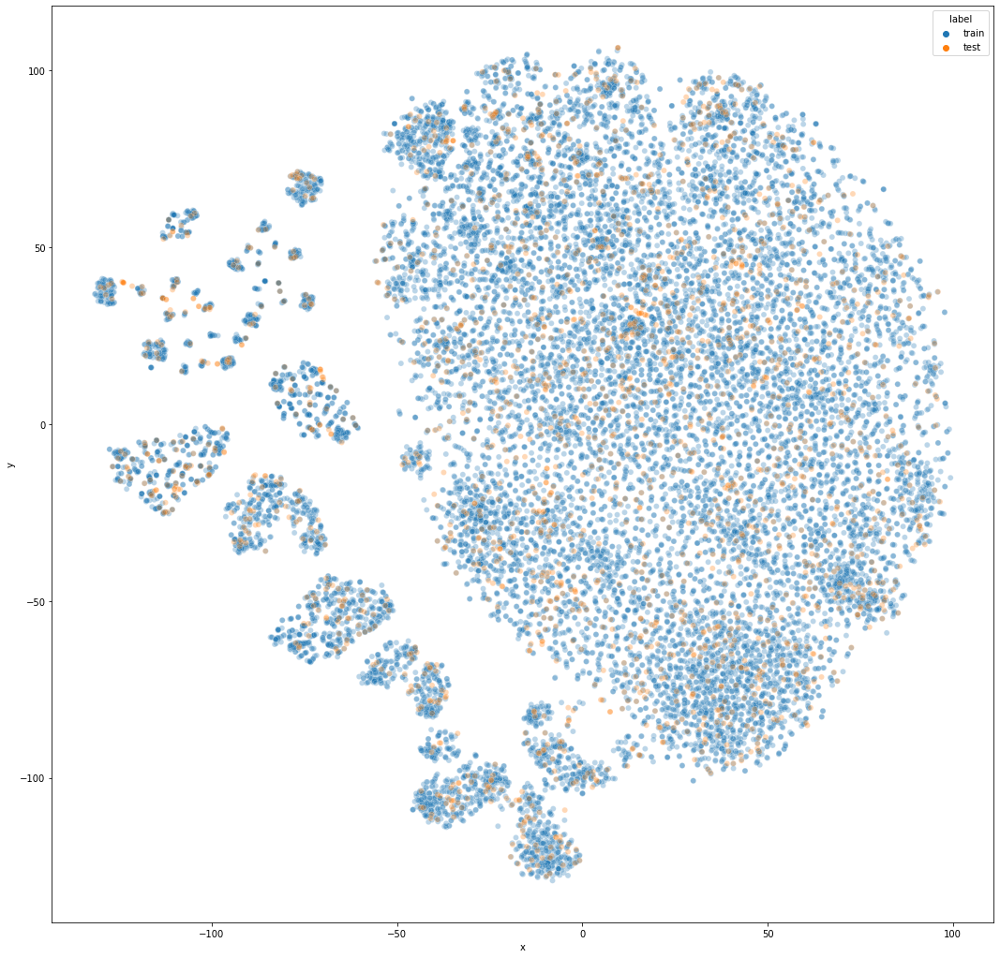

In [315]:
fig, ax = plt.subplots(1, 1, figsize=(18, 18))
sns.scatterplot(x="x", y="y", hue="label", data=df, sizes=30, alpha=0.3, ax=ax)

In [329]:
import bokeh

In [330]:
bokeh.__version__

'2.3.1'

In [390]:
from bokeh.models.sources import ColumnDataSource
from bokeh.plotting import output_notebook, figure, show

In [391]:
color_map = {'train' : 'red', 'test': 'green'}
colors = [color_map[x] for x in df.label]

In [392]:
df["userID"] = user_id
df["firstClass"] = first_class

In [393]:
tooltips = [
    ("index", "$index"),
    ("bill & tip", "(@total_bill, @tip)"),
    ("sex & smoker", "@sex, smoker? @smoker")
]

In [404]:
tips_df

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2
4,24.59,3.61,Female,No,Sun,Dinner,4
...,...,...,...,...,...,...,...
239,29.03,5.92,Male,No,Sat,Dinner,3
240,27.18,2.00,Female,Yes,Sat,Dinner,2
241,22.67,2.00,Male,Yes,Sat,Dinner,2
242,17.82,1.75,Male,No,Sat,Dinner,2


In [401]:
df.reset_index()

,index,0,1,2,3,4,5,6,7,8,...,95,96,97,98,99,label,x,y,userID,firstClass
0,0,0.737593,0.630872,0.555160,0.642942,0.0,0.737593,0.630872,0.851986,0.777617,...,0.737593,0.630872,0.216606,0.463125,0.0,train,64.730690,20.581772,0.0,2.0
1,1,0.709232,0.630872,0.273543,0.499680,0.0,0.709232,0.630872,0.729358,0.683486,...,0.709232,0.630872,0.752174,0.802174,1.0,train,-33.125961,25.785851,0.0,6.0
2,2,0.502598,0.630872,0.478261,0.757246,0.0,0.502598,0.630872,0.826087,0.757246,...,0.502598,0.630872,0.155125,0.360111,0.0,train,-1.581366,-49.770771,0.0,8.0
3,3,0.684056,0.853162,0.947368,0.818045,1.0,0.684056,0.853162,0.875940,0.818045,...,0.684056,0.853162,0.518519,0.621481,0.0,train,22.071949,18.449795,1.0,4.0
4,4,0.449948,0.853162,0.422222,0.336111,1.0,0.449948,0.853162,0.422222,0.336111,...,0.449948,0.853162,0.466667,0.425926,1.0,train,-30.729778,-29.490055,1.0,9.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19734,19734,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,0.658208,0.400000,0.853333,0.745556,-1.0,test,-110.554062,54.367317,7416.0,5.0
19735,19735,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,0.502598,0.400000,0.594595,0.762012,0.0,test,-73.522537,5.336397,7416.0,8.0
19736,19736,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,0.800876,0.066667,0.778502,0.784365,0.0,test,-45.100025,-63.084454,7417.0,1.0
19737,19737,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,0.658208,0.066667,0.853333,0.745556,-1.0,test,-110.543861,54.324360,7417.0,5.0


In [409]:
df = df.rename(columns={i: str(i) for i in range(100)})

In [410]:
df_c = ColumnDataSource(df)

In [411]:
df_c

ColumnDataSource(id='1984', ...)

In [420]:
from bokeh.transform import factor_cmap, factor_mark

labels = ['train', 'test']
colors = ["#1f77b4", "#ff7f0e"]

In [431]:
from bokeh.palettes import Category10_9

In [432]:
Category10_9

('#1f77b4',
 '#ff7f0e',
 '#2ca02c',
 '#d62728',
 '#9467bd',
 '#8c564b',
 '#e377c2',
 '#7f7f7f',
 '#bcbd22')

In [434]:
df.firstClass.unique()

array([2., 6., 8., 4., 9., 3., 5., 1., 7.])

In [435]:
from bokeh.palettes import RdBu11
from bokeh.transform import linear_cmap

color_func = linear_cmap(
    field_name = "firstClass",
    palette = Category10_9,
    low=1, high=9
)

In [443]:
grouped = df.groupby("firstClass")

In [444]:
df_g = ColumnDataSource(grouped)

In [451]:
gg = [g[1] for g in grouped]

In [453]:
gg[0]

,0,1,2,3,4,5,6,7,8,9,...,95,96,97,98,99,label,x,y,userID,firstClass
7,0.800876,0.795918,0.942857,0.669206,1.0,0.800876,0.795918,0.923810,0.669206,1.0,...,0.800876,0.795918,0.517799,0.786408,0.0,train,97.511047,-9.699520,5.0,1.0
15,0.800876,0.641791,0.841270,0.852063,1.0,0.800876,0.641791,0.777778,0.852063,1.0,...,0.800876,0.641791,0.705696,0.825316,0.0,train,19.196690,26.817530,8.0,1.0
28,0.800876,0.510574,0.525806,0.649194,1.0,0.800876,0.510574,0.822581,0.649194,1.0,...,0.800876,0.510574,0.859935,0.870793,1.0,train,27.163738,81.905006,14.0,1.0
34,0.800876,0.820031,0.781759,0.634528,1.0,0.800876,0.820031,0.628664,0.634528,0.0,...,0.800876,0.820031,0.389068,0.763344,1.0,train,-1.445018,48.102325,16.0,1.0
36,0.800876,0.763729,0.776699,0.738673,1.0,0.800876,0.763729,0.893204,0.738673,1.0,...,0.800876,0.763729,0.715655,0.833866,0.0,train,35.804394,16.128315,18.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19703,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,...,0.800876,0.666667,0.851613,0.649194,-1.0,test,-55.481991,-67.421120,7308.0,1.0
19706,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,...,0.800876,0.400000,0.559748,0.791824,0.0,test,-119.110435,36.890404,7354.0,1.0
19709,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,...,0.800876,0.714286,0.778502,0.784365,1.0,test,-73.827843,35.384232,7363.0,1.0
19724,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,...,0.800876,0.611111,0.501577,0.835331,-1.0,test,-123.949501,39.994087,7392.0,1.0


In [455]:
tooltips = [
    ("index", "$index"),
    ("userID", "@userID"),
    ("firstClass", "@firstClass"),
    ("label", "@label")
]

p = figure(title="clustering sequence", height=800, width=800, tooltips=tooltips)

p.scatter(
    x="x",
    y="y",
    color=factor_cmap('label', colors, labels),
#     color=color_func,
    source=gg[0],
    alpha=0.5,
    size=10)
output_notebook()

Loading BokehJS ...

In [456]:
# firstClass 별로 

show(p)

In [463]:
gg[0].iloc[2298:2299]

,0,1,2,3,4,5,6,7,8,9,...,95,96,97,98,99,label,x,y,userID,firstClass
19709,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.800876,0.714286,0.778502,0.784365,1.0,test,-73.827843,35.384232,7363.0,1.0


In [480]:
gg[0].iloc[
    np.array([2298, 1568, 1927, 2036, 1915, 1663, 1592, 1808, 1874, 1932])
].iloc[:, 70:90]

,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89
19709,0.0,0.0,0.0,0.0,0.0,0.800876,0.714286,0.622150,0.784365,1.0,0.800876,0.714286,0.885993,0.784365,1.0,0.800876,0.714286,0.768730,0.784365,1.0
13480,0.0,0.0,0.0,0.0,0.0,0.800876,0.680851,0.837134,0.760912,1.0,0.800876,0.680851,0.944625,0.760912,1.0,0.800876,0.680851,0.657980,0.760912,1.0
16591,0.0,0.0,0.0,0.0,0.0,0.800876,0.750000,0.896552,0.764890,1.0,0.800876,0.750000,0.830721,0.764890,1.0,0.800876,0.750000,0.739812,0.764890,1.0
17429,0.0,0.0,0.0,0.0,0.0,0.800876,0.750000,0.862620,0.833866,1.0,0.800876,0.750000,0.932907,0.833866,1.0,0.800876,0.750000,0.926518,0.833866,1.0
16494,0.0,0.0,0.0,0.0,0.0,0.800876,0.705882,0.862620,0.833866,1.0,0.800876,0.705882,0.932907,0.833866,1.0,0.800876,0.705882,0.926518,0.833866,1.0
14281,0.0,0.0,0.0,0.0,0.0,0.800876,0.767442,0.959459,0.893694,1.0,0.800876,0.767442,0.918919,0.893694,1.0,0.800876,0.767442,0.941441,0.893694,1.0
13634,0.0,0.0,0.0,0.0,0.0,0.800876,0.607477,0.812102,0.822293,1.0,0.800876,0.607477,0.761146,0.822293,1.0,0.800876,0.607477,0.901274,0.822293,1.0
15620,0.0,0.0,0.0,0.0,0.0,0.800876,0.454545,0.889937,0.815094,1.0,0.800876,0.454545,0.959119,0.815094,1.0,0.800876,0.454545,0.902516,0.815094,1.0
16165,0.0,0.0,0.0,0.0,0.0,0.800876,0.500000,0.862620,0.833866,1.0,0.800876,0.500000,0.932907,0.833866,1.0,0.800876,0.500000,0.926518,0.833866,1.0
16627,0.0,0.0,0.0,0.0,0.0,0.800876,0.454545,0.862620,0.833866,1.0,0.800876,0.454545,0.932907,0.833866,1.0,0.800876,0.454545,0.926518,0.833866,1.0


In [482]:
gg[0].iloc[
    np.array([2123, 2206, 2183, 897, 734, 1121, 956, 1129, 255])
]

,0,1,2,3,4,5,6,7,8,9,...,95,96,97,98,99,label,x,y,userID,firstClass
18192,0.800876,0.868275,0.631746,0.787302,1.0,0.800876,0.868275,0.909091,0.667532,1.0,...,0.800876,0.868275,0.552795,0.756988,1.0,test,-31.763052,89.759758,1614.0,1.0
18904,0.800876,0.757062,0.778846,0.803419,1.0,0.800876,0.757062,0.830128,0.803419,1.0,...,0.800876,0.757062,0.517799,0.786408,1.0,test,-31.775776,88.963043,4350.0,1.0
18685,0.800876,0.829146,0.889937,0.815094,1.0,0.800876,0.829146,0.959119,0.815094,1.0,...,0.800876,0.829146,0.898734,0.815823,1.0,test,-31.937977,89.447556,3372.0,1.0
7268,0.800876,0.875676,0.795455,0.747727,1.0,0.800876,0.875676,0.847826,0.804348,1.0,...,0.800876,0.875676,0.790698,0.794574,1.0,train,-31.650869,89.855644,3029.0,1.0
6073,0.800876,0.634354,0.898734,0.772785,1.0,0.800876,0.634354,0.870253,0.772785,1.0,...,0.800876,0.634354,0.356688,0.670064,1.0,train,-30.554926,87.985527,2539.0,1.0
9242,0.800876,0.645503,0.868339,0.729154,1.0,0.800876,0.645503,0.670846,0.729154,1.0,...,0.800876,0.645503,0.711111,0.715556,1.0,train,-30.342222,88.014923,3853.0,1.0
7757,0.800876,0.638955,0.842444,0.810932,1.0,0.800876,0.638955,0.890675,0.810932,1.0,...,0.800876,0.638955,0.642173,0.729712,1.0,train,-29.957392,87.479965,3232.0,1.0
9301,0.800876,0.624595,0.914013,0.908280,1.0,0.800876,0.624595,0.926752,0.908280,1.0,...,0.800876,0.624595,0.750000,0.764557,1.0,train,-31.745251,87.784630,3880.0,1.0
2176,0.800876,0.767978,0.936102,0.905431,1.0,0.800876,0.767978,0.881789,0.905431,1.0,...,0.800876,0.767978,0.864952,0.881029,1.0,train,-32.274059,88.565277,917.0,1.0


In [487]:
import faiss

In [493]:
import numpy as np
d = 100                           # dimension
nb = 100000                      # database size
nq = 10000                       # nb of queries
np.random.seed(1234)             # make reproducible
xb = np.random.random((nb, d)).astype('float32')
xb[:, 0] += np.arange(nb) / 1000.
xq = np.random.random((nq, d)).astype('float32')
xq[:, 0] += np.arange(nq) / 1000.

In [494]:
xb.shape

(100000, 100)

In [496]:
xb[:, 0]

array([  0.19151945,   0.7681166 ,   0.9810388 , ..., 100.61597   ,
       100.22012   , 100.61346   ], dtype=float32)

In [532]:
index = faiss.IndexFlatL2(100)

In [533]:
print(index.is_trained)

True


In [534]:
train_xy = train_xy.astype(np.float32)
total_xy = total_xy.astype(np.float32)

In [535]:
index.add(total_xy)

In [540]:
D, I = index.search(total_xy[17752:17762], 10)

In [541]:
D  # 유사도

array([[0.       , 2.6081142, 3.4129794, 3.4260387, 3.55125  , 3.5836716,
        3.5866804, 3.5978193, 3.611262 , 3.6735046],
       [0.       , 4.8060403, 4.9088006, 5.032332 , 5.1616554, 5.197303 ,
        5.336384 , 5.4026537, 5.4201756, 5.421676 ],
       [0.       , 0.7668371, 1.0534151, 1.4364607, 1.8010122, 1.8465792,
        1.8818613, 1.8998688, 1.9089779, 1.9771472],
       [0.       , 2.8390195, 2.8455126, 2.9336514, 3.0184808, 3.0533657,
        3.1658998, 3.1835275, 3.2099326, 3.280322 ],
       [0.       , 6.0656514, 6.182579 , 6.1965504, 6.382782 , 6.5391817,
        6.5445533, 6.634656 , 6.656492 , 6.6878686],
       [0.       , 1.268785 , 1.531668 , 1.5951871, 1.6531988, 1.6830947,
        1.81953  , 1.8618217, 1.935029 , 1.9835519],
       [0.       , 1.3211069, 2.0284321, 2.1758232, 2.2067022, 2.2463677,
        2.2792463, 2.2893572, 2.3510349, 2.354776 ],
       [0.       , 4.39651  , 5.2970715, 5.825693 , 5.85104  , 6.4443707,
        6.459259 , 6.4737883, 6.50638

In [542]:
I  # 

array([[17752, 17807, 18150,  6710,  5395, 19268,  3629,  6554,  4241,
        12072],
       [17753,  2915, 11294, 13653,  1311, 15244,  4525, 13183, 19042,
          869],
       [17754,  8607, 18676, 11767,  5099,  1785, 10637, 11585, 10024,
        15789],
       [17755,  3114, 11748,   685, 10811, 18319,   236,  9052,  3992,
         2800],
       [17756, 19343, 18949,  9110, 17956,  4489,  2952,  9874,   473,
         1856],
       [17757, 10079,  5484,  3036,   110,  7257, 12098, 10806,  1525,
        19457],
       [17758, 14053, 18190, 15511, 11708, 14828, 14046, 11873,  9783,
         5654],
       [17759, 10561,  3092, 18724,  1424,  3555, 11589, 18062,  5312,
         1969],
       [17760, 13787, 12608,  9102, 18564,  8534, 12444, 13468,  2206,
         8738],
       [17761,  5198, 12524,  4013,  6083,  4010,  4346,   849,  8376,
         8000]])

In [543]:
df.iloc[I[0]]

,0,1,2,3,4,5,6,7,8,9,...,95,96,97,98,99,label,x,y,userID,firstClass
17752,0.737593,0.691120,0.616541,0.672932,1.0,0.737593,0.691120,0.695489,0.672932,1.0,...,0.737593,0.691120,0.369811,0.398491,0.0,test,-9.578581,-12.572080,3.0,2.0
17807,0.658208,0.795411,0.473684,0.584211,1.0,0.658208,0.795411,0.640351,0.584211,1.0,...,0.658208,0.795411,0.488889,0.482667,0.0,test,-9.569225,-12.566697,217.0,5.0
18150,0.658208,0.805320,0.627193,0.584211,1.0,0.658208,0.805320,0.473684,0.584211,1.0,...,0.658208,0.805320,0.488889,0.482667,0.0,test,44.364765,25.724089,1425.0,5.0
6710,0.737593,0.751479,0.706383,0.861277,1.0,0.737593,0.751479,0.617021,0.758511,1.0,...,0.737593,0.751479,0.187050,0.553957,0.0,train,24.729240,36.267662,2800.0,2.0
5395,0.658208,0.810680,0.840183,0.775603,1.0,0.658208,0.810680,0.808219,0.775603,1.0,...,0.658208,0.810680,0.477011,0.562397,1.0,train,-17.282898,48.704914,2255.0,5.0
19268,0.658208,0.496350,0.680000,0.594921,1.0,0.658208,0.496350,0.662222,0.594921,1.0,...,0.658208,0.496350,0.473451,0.576485,0.0,test,7.043223,21.426210,5608.0,5.0
3629,0.709232,0.499289,0.808036,0.779974,1.0,0.709232,0.499289,0.875000,0.779974,1.0,...,0.709232,0.499289,0.190698,0.441860,0.0,train,49.558144,10.349990,1515.0,6.0
6554,0.737593,0.675639,0.608059,0.701099,1.0,0.737593,0.675639,0.388278,0.701099,0.0,...,0.737593,0.675639,0.260684,0.665812,0.0,train,25.158710,36.034775,2737.0,2.0
4241,0.684056,0.735974,0.913858,0.752185,1.0,0.684056,0.735974,0.779026,0.752185,1.0,...,0.684056,0.735974,0.606061,0.621212,0.0,train,24.091585,25.971998,1768.0,4.0
12072,0.502598,0.693380,0.447222,0.554630,1.0,0.502598,0.693380,0.611111,0.554630,1.0,...,0.502598,0.693380,0.353425,0.540753,0.0,train,-10.545156,-22.061981,5036.0,8.0


In [47]:
train_xy.shape, test_xy.shape

((17752, 100), (1987, 100))

In [48]:
feature_data.userID.nunique(), t_data.userID.nunique()

(6698, 744)

In [117]:
import faiss
from tqdm.auto import tqdm

In [191]:
t_data.firstClass.unique()

array([5, 2, 4, 7, 1, 6, 9, 8, 3])

In [193]:
idx

1

In [227]:
t_data[t_data.answerCode == -1]

,userID,assessmentItemID,testId,answerCode,Timestamp,KnowledgeTag,userPer,assPer,firstClass,firPer,testPer
13891,566,A050151007,A050000151,-1,2020-10-23 10:29:55,445,0.467275,0.530973,5,0.658208,0.660556
15090,3469,A050113007,A050000113,-1,2020-10-26 06:13:25,5285,0.622449,0.579646,5,0.658208,0.713021
15440,6833,A050115007,A050000115,-1,2020-10-16 22:33:26,5286,0.391304,0.656388,5,0.658208,0.644430
15768,6332,A050126007,A050000126,-1,2020-10-22 10:53:57,5288,0.719298,0.437500,5,0.658208,0.582908
16210,1266,A050136006,A050000136,-1,2020-10-21 23:20:54,5300,0.500000,0.424242,5,0.658208,0.587302
...,...,...,...,...,...,...,...,...,...,...,...
259801,2965,A030170005,A030000170,-1,2020-10-26 10:57:21,1874,0.840183,0.583942,3,0.702238,0.816058
259951,5543,A030178005,A030000178,-1,2020-10-23 12:31:28,1934,0.711111,0.359551,3,0.702238,0.681648
260025,4002,A030182005,A030000182,-1,2020-10-26 09:47:26,1964,0.473430,0.945055,3,0.702238,0.925824
260111,1721,A030198005,A030000198,-1,2020-10-21 09:21:06,1984,0.424699,0.531915,3,0.702238,0.740426


In [228]:
feature_data.firstClass.unique()

array([6, 8, 2, 4, 9, 3, 5, 1, 7])

In [246]:
train_data = train_data.sort_values(["userID", "Timestamp"], axis=0).reset_index(drop=True)
t_data = t_data.sort_values(["userID", "Timestamp", "assessmentItemID"], axis=0).reset_index(drop=True)

In [285]:
user_ids = []
preds = []

# 대 분류별 Vector Fit, 

for first_grouped in feature_data.groupby(["firstClass"]):
    train_x = []
    train_y = []
    
    for g in tqdm(first_grouped[1].groupby(["userID", "testId"]), desc="Make Train Dataset"):
        vector_x, vector_y = make_vector_with_paddded(g)
        train_x.append(vector_x)
        train_y.append(vector_y)
        
    train_x = np.array(train_x)
    train_y = np.array(train_y)
    
    train_xy = np.concatenate([train_x, train_y], axis=-1)
    train_xy = train_xy.reshape(-1, 100)
    train_ly = train_xy[:, -1]
    train_xy = train_xy[:, :-1]  # 99
    
    test_x = []
    test_y = []
    
    for tg in t_data[t_data.firstClass == first_grouped[0]].groupby(["userID", "testId"]):
        user_id = tg[1].iloc[0].userID
        
        if user_id in {257, 802, 2422, 4723, 5007}:
            temp = tg[1].iloc[-2].copy()
            tg[1].iloc[-2] = tg[1].iloc[-1]
            tg[1].iloc[-1] = temp
        
        if tg[1].iloc[-1].answerCode != -1:
            continue
        
        
        vector_x, vector_y = make_vector_with_paddded(tg)        
        test_x.append(vector_x)
        test_y.append(vector_y)
        
        user_ids.append(user_id)
        
    test_x = np.array(test_x)
    test_y = np.array(test_y)
    
    test_xy = np.concatenate([test_x, test_y], axis=-1)
    test_xy = test_xy.reshape(-1, 100)
    test_ly = test_xy[:, -1]
    test_xy = test_xy[:, :-1] # 99
    
    train_xy = train_xy.astype(np.float32)
    test_xy = test_xy.astype(np.float32)
    
    index = faiss.IndexFlatL2(99)
    index.add(train_xy)
    
    D, I = index.search(test_xy, 10)
    pred = train_ly[I[:, 1:]].mean(axis=1)
    
    preds.append(pred)

In [286]:
wp = np.concatenate(preds)

In [291]:
import os

write_path = os.path.join(".", f"cluster_test_results.csv")

with open(write_path, "w", encoding="utf8") as w:
    w.write("id,prediction\n")
    for idx, proba in enumerate(wp):
        w.write(f"{idx},{proba}\n")

In [289]:
wp

array([1.        , 0.88888889, 1.        , 1.        , 0.77777778,
       0.77777778, 0.88888889, 0.33333333, 0.22222222, 1.        ,
       0.22222222, 1.        , 0.        , 1.        , 0.55555556,
       1.        , 1.        , 0.66666667, 0.22222222, 0.55555556,
       1.        , 0.88888889, 1.        , 0.88888889, 0.77777778,
       0.77777778, 0.77777778, 0.88888889, 0.77777778, 0.77777778,
       1.        , 1.        , 1.        , 0.55555556, 1.        ,
       0.88888889, 0.22222222, 0.55555556, 0.66666667, 0.77777778,
       0.11111111, 0.88888889, 0.88888889, 0.33333333, 0.44444444,
       0.88888889, 0.33333333, 0.77777778, 0.44444444, 0.33333333,
       1.        , 0.44444444, 0.66666667, 0.66666667, 0.66666667,
       0.77777778, 0.44444444, 0.33333333, 0.11111111, 1.        ,
       1.        , 0.88888889, 0.77777778, 0.33333333, 0.44444444,
       1.        , 0.88888889, 0.66666667, 0.77777778, 0.77777778,
       0.44444444, 0.88888889, 0.44444444, 0.88888889, 0.44444

In [287]:
wp.shape

(744,)

In [288]:
wp[3]

1.0

In [131]:
import faiss

index = faiss.IndexFlatL2(99)
index.add(train_xy)

In [132]:
D, I = index.search(train_xy, 10)

In [135]:
D[2]

array([0.0000000e+00, 0.0000000e+00, 3.0517578e-05, 4.9591064e-05,
       3.7765503e-04, 4.9133301e-03, 4.9324036e-03, 6.0386658e-03,
       1.4823914e-02, 4.8892975e-02], dtype=float32)

In [155]:
I[0, ]

array([    0, 18506, 25815, 47477,  7340, 36536, 23826, 17990, 14600,
       41379])

In [154]:
I[0, 1:]

array([18506, 25815, 47477,  7340, 36536, 23826, 17990, 14600, 41379])

In [156]:
preds = np.where(train_ly[I[:, 1:]].mean(axis=1) >=0.5, 1, 0)

In [ ]:
train_xy.reshape

In [158]:
train_ly.shape, preds.shape

((51973,), (51973,))

In [161]:
(train_ly == preds).sum() / 51973

0.7624343409077791

In [81]:
tg[1]

,userID,assessmentItemID,testId,answerCode,Timestamp,KnowledgeTag,userPer,assPer,firstClass,firPer,testPer
148095,94,A010146001,A010000146,1,2020-10-26 11:09:07,7803,0.840557,0.954887,1,0.800876,0.914286
148112,94,A010146002,A010000146,1,2020-10-26 11:10:31,7803,0.840557,0.932331,1,0.800876,0.914286
148129,94,A010146003,A010000146,1,2020-10-26 11:10:56,7803,0.840557,0.789474,1,0.800876,0.914286
148146,94,A010146004,A010000146,1,2020-10-26 11:11:06,7803,0.840557,0.969925,1,0.800876,0.914286
148163,94,A010146005,A010000146,-1,2020-10-26 11:11:21,7803,0.840557,0.924812,1,0.800876,0.914286


In [165]:
from sklearn.model_selection import cross_val_score
from sklearn.neighbors import KNeighborsClassifier

In [164]:
knn_cls = KNeighborsClassifier(n_neighbors=10)

In [168]:
cross_val_score(knn_cls, train_xy, train_ly, scoring='accuracy', cv=5, verbose=1)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:   42.1s finished


array([0.74978355, 0.74939875, 0.75584416, 0.76063113, 0.74398692])

In [58]:
train_xy.shape, train_ly.shape

((2074, 99), (2074,))

In [64]:
a, b = make_vector_with_paddded(tg)

In [66]:
a.shape, b.shape

((20, 4), (20, 1))

In [83]:
test_y[: -1]

[]

In [591]:
train_xy.shape

(2074, 20, 5)

In [ ]:
train_xy.

In [589]:
g.iloc[-1].answerCode

1

In [585]:
g[g.answerCode == -1]

,userID,assessmentItemID,testId,answerCode,Timestamp,KnowledgeTag,userPer,assPer,firstClass,firPer,testPer


In [588]:
t_data[t_data.userID == 4].firstClass[]

,userID,assessmentItemID,testId,answerCode,Timestamp,KnowledgeTag,userPer,assPer,firstClass,firPer,testPer
59650,4,A040001001,A040000001,1,2020-02-11 04:13:36,7271,0.691505,0.969811,4,0.684056,0.893585
59685,4,A040001002,A040000001,1,2020-02-11 04:13:44,7271,0.691505,0.909434,4,0.684056,0.893585
59720,4,A040001003,A040000001,1,2020-02-11 04:14:01,7271,0.691505,0.913208,4,0.684056,0.893585
59755,4,A040001004,A040000001,1,2020-02-11 04:14:12,7271,0.691505,0.867925,4,0.684056,0.893585
59790,4,A040001005,A040000001,1,2020-02-11 04:14:22,7271,0.691505,0.807547,4,0.684056,0.893585
...,...,...,...,...,...,...,...,...,...,...,...
133421,4,A010132001,A010000132,1,2020-10-20 08:34:54,6794,0.691505,0.817778,1,0.800876,0.715556
133446,4,A010132002,A010000132,1,2020-10-20 08:36:22,6794,0.691505,0.733333,1,0.800876,0.715556
133471,4,A010132003,A010000132,1,2020-10-20 08:37:43,6794,0.691505,0.675556,1,0.800876,0.715556
133496,4,A010132004,A010000132,1,2020-10-20 08:40:22,6794,0.691505,0.640000,1,0.800876,0.715556


In [574]:
idxtrain_ly = t

1

In [572]:
np.array(train_x).shape

(2074, 20, 4)

In [565]:
for gg in g.groupby("userID"):
    break

In [569]:
gg[0]

5

In [568]:
make_vector_with_paddded(gg)

(array([[0.80087621, 0.79591837, 0.94285714, 0.66920635],
        [0.80087621, 0.79591837, 0.92380952, 0.66920635],
        [0.80087621, 0.79591837, 0.81904762, 0.66920635],
        [0.80087621, 0.79591837, 0.3047619 , 0.66920635],
        [0.80087621, 0.79591837, 0.35555556, 0.66920635],
        [0.80087621, 0.79591837, 0.79099678, 0.65219721],
        [0.80087621, 0.79591837, 0.45980707, 0.65219721],
        [0.80087621, 0.79591837, 0.8392283 , 0.65219721],
        [0.80087621, 0.79591837, 0.69453376, 0.65219721],
        [0.80087621, 0.79591837, 0.43086817, 0.65219721],
        [0.80087621, 0.79591837, 0.6977492 , 0.65219721],
        [0.80087621, 0.79591837, 0.92207792, 0.87402597],
        [0.80087621, 0.79591837, 0.93506494, 0.87402597],
        [0.80087621, 0.79591837, 0.9025974 , 0.87402597],
        [0.80087621, 0.79591837, 0.87662338, 0.87402597],
        [0.80087621, 0.79591837, 0.73376623, 0.87402597],
        [0.80087621, 0.79591837, 0.80582524, 0.78640777],
        [0.800

In [559]:
t_data.groupby("firstClass").size().reset_index()

,firstClass,0
0,1,31668
1,2,29023
2,3,29688
3,4,33177
4,5,30627
5,6,31916
6,7,36136
7,8,25614
8,9,12265


In [557]:
t_data[t_data.userID == idx[0]]

,userID,assessmentItemID,testId,answerCode,Timestamp,KnowledgeTag,userPer,assPer,firstClass,firPer,testPer


In [552]:
g

,userID,assessmentItemID,testId,answerCode,Timestamp,KnowledgeTag,userPer,assPer,firstClass,firPer,testPer
510770,0,A020172001,A020000172,1,2020-10-11 11:06:47,8132,0.630872,0.609155,2,0.737593,0.581573
511054,0,A020172002,A020000172,1,2020-10-11 11:06:56,8132,0.630872,0.552817,2,0.737593,0.581573
511338,0,A020172003,A020000172,1,2020-10-11 11:07:13,8132,0.630872,0.440141,2,0.737593,0.581573
511622,0,A020172004,A020000172,1,2020-10-11 11:07:46,8132,0.630872,0.577465,2,0.737593,0.581573
511906,0,A020172005,A020000172,0,2020-10-11 11:08:20,8132,0.630872,0.750000,2,0.737593,0.581573
512190,0,A020172006,A020000172,0,2020-10-11 11:10:01,8132,0.630872,0.559859,2,0.737593,0.581573
512474,0,A020174001,A020000174,1,2020-10-17 10:56:12,8134,0.630872,0.762590,2,0.737593,0.550360
512752,0,A020174002,A020000174,1,2020-10-17 10:56:46,8134,0.630872,0.705036,2,0.737593,0.550360
513030,0,A020174003,A020000174,1,2020-10-17 10:57:35,8134,0.630872,0.528777,2,0.737593,0.550360
513308,0,A020174004,A020000174,1,2020-10-17 10:58:15,8134,0.630872,0.615108,2,0.737593,0.550360


In [549]:
feature_data

,userID,assessmentItemID,testId,answerCode,Timestamp,KnowledgeTag,userPer,assPer,firstClass,firPer,testPer
0,0,A060001001,A060000001,1,2020-03-24 00:17:11,7224,0.630872,0.982063,6,0.709232,0.947683
1,10,A060001001,A060000001,1,2020-03-05 02:55:20,7224,0.851351,0.982063,6,0.709232,0.947683
2,20,A060001001,A060000001,1,2020-03-03 05:52:03,7224,0.587744,0.982063,6,0.709232,0.947683
3,32,A060001001,A060000001,1,2020-03-03 23:27:08,7224,0.453376,0.982063,6,0.709232,0.947683
4,36,A060001001,A060000001,1,2020-02-28 16:38:08,7224,0.464552,0.982063,6,0.709232,0.947683
...,...,...,...,...,...,...,...,...,...,...,...
2266581,5864,A070014008,A070000014,0,2020-04-15 05:32:00,3795,0.638298,0.277533,7,0.521876,0.512971
2266582,6177,A070014008,A070000014,1,2020-05-18 02:05:40,3795,0.843137,0.277533,7,0.521876,0.512971
2266583,6228,A070014008,A070000014,1,2020-03-26 01:05:57,3795,0.682927,0.277533,7,0.521876,0.512971
2266584,6461,A070014008,A070000014,0,2020-03-19 22:58:42,3795,0.322222,0.277533,7,0.521876,0.512971


In [550]:
t_data

,userID,assessmentItemID,testId,answerCode,Timestamp,KnowledgeTag,userPer,assPer,firstClass,firPer,testPer
0,3,A050023001,A050000023,1,2020-01-09 10:56:31,2626,0.691120,0.646789,5,0.658208,0.560944
1,3,A050023001,A050000023,0,2020-04-02 07:39:56,2626,0.691120,0.646789,5,0.658208,0.560944
2,159,A050023001,A050000023,0,2020-04-02 06:38:47,2626,0.749467,0.646789,5,0.658208,0.560944
3,200,A050023001,A050000023,1,2020-02-02 11:15:13,2626,0.737557,0.646789,5,0.658208,0.560944
4,325,A050023001,A050000023,1,2020-05-04 07:50:28,2626,0.817728,0.646789,5,0.658208,0.560944
...,...,...,...,...,...,...,...,...,...,...,...
260109,2786,A030198004,A030000198,0,2020-10-21 08:56:38,1984,0.540936,0.553191,3,0.702238,0.740426
260110,7364,A030198004,A030000198,1,2020-08-23 14:07:51,1984,0.681818,0.553191,3,0.702238,0.740426
260111,1721,A030198005,A030000198,-1,2020-10-21 09:21:06,1984,0.424699,0.531915,3,0.702238,0.740426
260112,2786,A030198005,A030000198,-1,2020-10-21 08:56:49,1984,0.540936,0.531915,3,0.702238,0.740426


## Linear Regression 으로 테스트

In [39]:
from sklearn.svm import SVC
from sklearn.metrics import roc_auc_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score

In [40]:
lin_reg = LinearRegression()
scores = cross_val_score(lin_reg, new_data, y, scoring="roc_auc", cv=5)

In [44]:
print(scores, scores.mean(), sep="\n")

[0.75628196 0.76119147 0.78781717 0.76838437 0.77733664]
0.7702023206391435


In [45]:
svm_clf = SVC()
scores = cross_val_score(svm_clf, new_data, y, scoring="roc_auc", cv=5)

In [46]:
print(scores, scores.mean(), sep="\n")

[0.74464919 0.75872145 0.77766855 0.7594182  0.76388262]
0.760868001390716


In [49]:
svm_clf = SVC(kernel="rbf")
scores = cross_val_score(svm_clf, new_data, y, scoring="roc_auc", cv=5)

In [50]:
print(scores, scores.mean(), sep="\n")

[0.74464919 0.75872145 0.77766855 0.7594182  0.76388262]
0.760868001390716


In [47]:
forest_reg = RandomForestClassifier()
scores = cross_val_score(forest_reg, new_data, y, scoring="roc_auc", cv=5)

In [48]:
print(scores, scores.mean(), sep="\n")

[0.70263879 0.71457023 0.73959458 0.7286081  0.73658058]
0.7243984550983102


In [55]:
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import reciprocal, uniform

param_distributions = {
    "gamma": reciprocal(0.001, 0.1), 
    "C": uniform(1, 10)
}

rnd_search_cv = RandomizedSearchCV(
    SVC(), 
    param_distributions, 
    n_iter=50, 
    verbose=2, 
    cv=3
)

In [56]:
rnd_search_cv.fit(new_data, y)

Fitting 3 folds for each of 50 candidates, totalling 150 fits
[CV] END ....C=3.5026425198754163, gamma=0.06554912379710451; total time=   3.7s
[CV] END ....C=3.5026425198754163, gamma=0.06554912379710451; total time=   3.8s
[CV] END ....C=3.5026425198754163, gamma=0.06554912379710451; total time=   3.8s
[CV] END .....C=6.772986196621846, gamma=0.07290790230240984; total time=   3.8s
[CV] END .....C=6.772986196621846, gamma=0.07290790230240984; total time=   3.9s
[CV] END .....C=6.772986196621846, gamma=0.07290790230240984; total time=   3.9s
[CV] END ...C=6.797111268199209, gamma=0.0018319285931370827; total time=   3.9s
[CV] END ...C=6.797111268199209, gamma=0.0018319285931370827; total time=   4.0s
[CV] END ...C=6.797111268199209, gamma=0.0018319285931370827; total time=   3.9s
[CV] END ..C=2.3563003085461043, gamma=0.0031431907884350648; total time=   3.9s
[CV] END ..C=2.3563003085461043, gamma=0.0031431907884350648; total time=   4.0s
[CV] END ..C=2.3563003085461043, gamma=0.003143

RandomizedSearchCV(cv=3, estimator=SVC(), n_iter=50,
                   param_distributions={'C': <scipy.stats._distn_infrastructure.rv_frozen object at 0x7f94f93a6430>,
                                        'gamma': <scipy.stats._distn_infrastructure.rv_frozen object at 0x7f94f93a63a0>},
                   verbose=2)

In [65]:
rnd_search_cv.best_estimator_

SVC(C=10.659972170199673, gamma=0.006340015784602972)

학습 데이터인데도 이렇게 뜨다니..

# PORORO 요약 체크 - 번외

In [169]:
from pororo import Pororo

In [107]:
Pororo.available_tasks()

"Available tasks are ['mrc', 'rc', 'qa', 'question_answering', 'machine_reading_comprehension', 'reading_comprehension', 'sentiment', 'sentiment_analysis', 'nli', 'natural_language_inference', 'inference', 'fill', 'fill_in_blank', 'fib', 'para', 'pi', 'cse', 'contextual_subword_embedding', 'similarity', 'sts', 'semantic_textual_similarity', 'sentence_similarity', 'sentvec', 'sentence_embedding', 'sentence_vector', 'se', 'inflection', 'morphological_inflection', 'g2p', 'grapheme_to_phoneme', 'grapheme_to_phoneme_conversion', 'w2v', 'wordvec', 'word2vec', 'word_vector', 'word_embedding', 'tokenize', 'tokenise', 'tokenization', 'tokenisation', 'tok', 'segmentation', 'seg', 'mt', 'machine_translation', 'translation', 'pos', 'tag', 'pos_tagging', 'tagging', 'const', 'constituency', 'constituency_parsing', 'cp', 'pg', 'collocation', 'collocate', 'col', 'word_translation', 'wt', 'summarization', 'summarisation', 'text_summarization', 'text_summarisation', 'summary', 'gec', 'review', 'review_s

In [108]:
summary = Pororo(task="summary", lang="kr")

In [109]:
sum_text = summary(
    "긴 이메일 읽기 힘드시죠? 만약 여러분들의 이메일을 읽고 자동으로 한줄 요약을 해준다면, 즉 TD;LR: 한문장을 메일 첫부분에 넣어 주면 어떨까요? 빠르게 이메일 내용을 파악하고 읽어 볼수 있겠죠 Gmail과 코랩으로 여기서는 누구나 할수 있는 메일을 전달하고 이 전달된 메일을 요약해서 다시 보내주는, 즉 이메일 요약전담을 두는 것입니다. 즉 이메일 하나를 순이의 이메일로 보내고, 그럼 순이는 이 메일을 읽고 요약본을 보내 주는 방식으로 함께 만들어 봅니다."
)

In [110]:
sum_text

'Gmail과 코랩으로 여기서는 누구나 할수 있는 메일을 전달하고 이 전달된 메일을 요약해서 다시 보내주는 이메일 요약전담을 두는 것입니다. 즉 이메일 하나를 순이의 이메일로 보내고, 그럼 순이는 이 메일을 읽고 요약본을 보내주는 방식으로 함께 만들어 봅니다.'

In [111]:
reader_txt = """이전 CNN 헤드를 설계하면서, 해당 모델이 768채널을 바로 2채널로 축소하므로 정보를 고르게 담아낼 수 없겠다는 생각이 들었습니다. CNN을 쌓아가면서 채널을 조금씩 축소하는 방법도 생각해보았지만, 모델의 복잡도가 너무 커질 것 같다는 우려가 있었습니다. 결론적으로 먼저 CNN 층을 통해 768채널을 256채널로 축소 후 concat하여 마지막에는 FC layer를 통과시키는 방법을 고안하였습니다. 벡터 크기의 급격한 축소로 인한 정보 손실을 방지할 수 있는 한편, 모델의 복잡도 또한 이전과 거의 비슷하게 유지할 수 있으므로, 결과적으로 이 모델은 이전 모델의 장점은 최대한 살리되 단점은 제거할 수 있습니다.
또한 CNN층과 Linear층 사이에 Dropout을 추가하였습니다. 우리에게 주어진 학습 데이터는 약 4000개 정도입니다. 모델의 복잡도에 비해 턱없이 적은 양이라고 생각했고, 이렇게 되면 모델이 적은 epoch에서도 금방 overfitting 될 우려가 있습니다.
저희는 Dropout을 통해 이를 해결하고자 하였고, 다양한 Dropout 수치를 실험해본 결과 0.5 이상의 비교적 높은 수치에서 유의미한 성능 향상이 나타나는 것을 확인하였습니다. 모델의 사이즈는 크고 학습 데이터의 양은 적은, 어떻게 보면 다소 비정상적인 구조였기 때문에 Dropout 수치를 크게 높이는 것이 유효했던 것 같습니다.
이전 CNN 모델에 비해 LB 기준 성능 향상은 거의 없었지만, Validation set 기준 시각화해보았을 때 어느정도 의미있는 성능 지표를 보였다고 생각합니다.
"""

In [115]:
reader_txt = reader_txt.replace("\n", " ")

In [116]:
rea_text = summary(reader_txt)

In [117]:
rea_text

'이전 CNN 헤드를 설계하면서 정보 손실을 방지하기 위해 CNN 층을 통해 768채널을 256채널로 축소하고 Dropout을 추가하였는데, 벡터 크기의 급격한 축소로 인한 정보 손실을 방지하고 모델의 복잡도 또한 이전과 거의 비슷하게 유지할 수 있으므로 이 모델은 이전 모델의 장점은 최대한 살리되 단점은 제거할 수 있다.'

In [149]:
jongheon_review = """이번 Stage에서는 지난 Stage 1, 2에서는 해보지 못했던 많은 일들을 해낸 것 같아 너무 뿌듯했습니다. 지난 스테이지들에서 저는 항상 리더보드 스코어만을 맹목적으로 좇았고 그 과정에서 결과적으로 남은 것이 적다는 느낌을 많이 받았습니다. 하지만 이번 스테이지에서는 제대로 된 협업 프로세스를 구축하고 정말 내가 잘하는 것이 뭔지, 내가 팀에게 기여할 수 있는 것이 뭔지 많이 생각해볼 수 있었습니다. 무엇보다도 지금까지의 부스트캠프 기간 중 지난 한 달의 시간동안 가장 많은 것을 얻었던 것 같습니다.
일단 저는 git을 잘 써보자!라는 막연한 목표를 가지고 이번 stage를 시작했습니다. 이전에 제대로 된 협업을 해본 경험이 없었고 옛날부터 항상 이 부분에 대한 갈증이 늘 심했었습니다. 그런데 결과적으로 이 부분에서는 제 자신에게 100점을 줄 수 있을 정도로, 목표 달성에 성공하였다고 생각합니다! git에 익숙한 팀원들에게 issue 관리, branch 관리 등 여러 git의 유용한 기능들을 다양하게 배울 수 있었고 ZenHub등의 플러그인을 활용하여 보다 효율적인 업무 시스템을 구축할 수 있었습니다. 가장 중요한 것은 좋은 도구들을 굉장히 효율적으로 사용했다는 점입니다. 늘 협업을 제대로 해보고 싶다라는 생각을 해왔었는데 좋은 팀원들 덕분에 이 모든 갈증을 해소할 수 있었다는 점에 너무 뿌듯하고 감사합니다.
다음으로 저는 하고 있는 것을 제대로 이해하자라는 목표도 있었습니다. 이전 스테이지들에서 너무 성능을 올리는 데에만 치중하며 시간을 보낸 나머지 코드 관리나 원리에 대한 깊은 이해 등을 제대로 해내지 못했기 때문입니다. Stage 2에서는 이러한 점을 스스로 인식하고 고치려고 노력하였으나 여전히 쉽지 않았습니다. 하지만 이 목표 역시 이번 스테이지의 팀원들과 함께 배워나가며 자연스레 이루어낼 수 있었습니다. 팀 내 뭐든 다같이 소통하며 해결나가자라는 분위기가 잘 형성되어 있었기 때문에 잘 이해되지 않는 것들은 소통을 통해 해결하였고, 다들 언제나 성심성의껏 답변해주셔서 스스로의 성장에 큰 도움이 되었던 것 같습니다. 오히려 너무 저 혼자 모르는 것들을 해결하고 남들에게는 공유하지 못했던 것은 아닌가 하는 생각이 들어 지금와서 이런 부분에 대한 반성을 하게 되네요…
저는 그동안 어떤 목표를 세우고 이를 성취하는 데에 실패했던 경험이 아주 많았습니다. 그래서 사실 이번 대회를 시작할 때에도 제가 세웠던 목표를 이룰 수 있을지, 뭔가 확신이 없었습니다. 그런데 한 달을 정신 없이 보내고나서 되돌아보니 목표 대부분을 이루어낸 것 같다는 생각이 듭니다. 굳이 의식하지 않았는데도요…! 세운 목표를 이루기 위해 제가 의식적으로 노력하는 것보다도, 자연스럽게 목표를 이룰 수 있도록 환경을 잘 조성하는 것이 얼마나 중요한지 깨달을 수 있었습니다.
가장 만족스러웠던 점은, 이렇게 어려운 task를 다루면서도 한 달이라는 긴 시간을 너무나 즐겁게 보낼 수 있었다는 것입니다. 한편으로는 이번 한 달이 너무나 빠르게 지나가 아쉽기도 합니다. Stage 4에서 과연 이보다 잘할 수 있을지, 이보다 더 만족스러운 한 달을 보낼 수 있을지 솔직히 두렵지만 부스트캠프 기간을 거치면서 계속해서 성장해왔기 때문에 다음 스테이지에서도 잘 할 수 있겠지 생각하며 이번 스테이지 회고를 마칩니다.
"""

In [150]:
jongheon_review = jongheon_review.replace("\n", " ")

In [157]:
jonghun_text = summary(jongheon_review, beam=30, len_penalty=3)

In [158]:
jonghun_text

'부스트캠프 기간 중 가장 많은 git을 잘 써보자라는 막연한 목표를 가지고 git에 익숙한 팀원들에게 issue 관리, branch 관리 등 여러 git의 유용한 기능들을 다양하게 배울 수 있었고 ZenHub등의 플러그인을 활용하여 효율적인 업무 시스템을 구축할 수 있었으며 이런 목표들을 잘 이루기 위해 한 달이라는 긴 시간동안 노력한 결과 이번 스테age 1, 2에서는 해보지 못했던 많은 일들을 해낸 것 같아 너무 뿌듯하다고 전했다.'

In [127]:
jongheon_review_split1 = jongheon_review[:len(jongheon_review) // 2]

In [128]:
jonghun_text = summary(jongheon_review_split1)

In [129]:
jonghun_text

'기존 된 협업을 해본 경험이 없었고 늘 협업을 해보고 싶었는데 좋은 팀원들 덕분에 이 모든 갈증을 해소할 수 있었다는 점에 너무 뿌듯하고 감사합니다.'

In [131]:
jongheon_review_split2 = jongheon_review[len(jongheon_review) // 2:]

In [132]:
jonghun_text = summary(jongheon_review_split2)

In [133]:
jonghun_text

'age 2에서는 그간 어떤 목표를 세우고 이를 성취하는 데에 실패했던 경험이 아주 많았는데, 팀 내 구성원들과 함께 소통하며 해결해 나가며 스스로의 성장에 큰 도움이 되었던 것 같고 가장 만족스러웠던 점은 이렇게 어려운 task를 다루면서도 한 달이라는 긴 시간을 너무나 즐겁게 보낼 수 있었다는 점입니다.'

In [134]:
seongik = """저번 스테이지를 진행하며 타인의 코드를 따라치는 게 아니라 제 코드를 직접 짜는 것이 얼마나 중요한 지 깨달았습니다. Stage 2에서는 매일매일의 daily mission과 강의를 따라가기에 급급했고, 일단 시키는대로 열심히 따라치고 나면 어떻게든 되겠지라는 생각이 있었습니다. 결국 저번 대회를 마무리할 때쯤 결국 이런 방식의 코드가 당장 모델 성능은 낼 수 있어도, 생각하는 힘은 길러주지 못한다는것을 느꼈습니다.
그렇기 때문에 이번에 팀 단위로 협업할 때에는 최대한 많은 코드를 뜯어보고 제 코드로 만들어보고 싶었습니다. 그러려면 팀끼리 소통이 정말 잘 되어야했고, 무엇보다 저와 비슷하게 주어진 코드를 따라가지 않으려는 분들이 많아야 했습니다. 그런 점에서 범블봇은 팀으로서 궁합이 정말 잘 맞았다고 생각합니다.
이번 스테이지에서 배운것, 얻어간 것의 대부분은 협업이었다고 생각합니다. 개발을 시작한 이후로 처음으로 PR을 날려보고, 코드리뷰를 받아보고, 짝프로그래밍을 했습니다. 가끔 도저히 오류를 알 수없는 날이면 zoom에서 화면을 공유하며 팀원들과 같이 디버깅을 하기도 했습니다. 덕분에 혼자였으면 해결할 수 없는 많은 문제들을 해결할 수 있었습니다.
팀원끼리 첫 소개를 할 때, 긴 회의를 싫어한다고 했었는데, 저희팀 회의는 매번 2시간 가까이 해도 정말 즐거웠습니다. TMI 세션도 처음에는 어색했지만 가면 갈수록 서로 썰자랑하는게 너무 귀엽고 재미있었습니다. 덕분에 단순히 피어로서가 아니라, 인간적으로 팀원들을 더 알아가고 싶다는 생각이 들었습니다.
또, 개인적으로는 Stage 1과 2를 거치면서 계속 AI를 공부하는게 맞나, 길을 잘못든 건 아닌가 하는 깊은 고민이 있었습니다. Stage 3때에도 초반에 팀원의 코드를 follow up하기도 힘든 스스로를 보면서 자괴감에 빠지는 날도 많았지만, 지금 돌이켜 보고 나니 그런 시간들이 있어서 좀 더 뻔뻔하게 모르는 것을 모른다고 말하고, 물을 수있게 되었습니다. 덕분에 '아무것도 모르는 사람’에서 '뭘 모르는지 아는 사람’으로 한발짝 다가섰다고 생각합니다.
좋은 점은 이야기하자면 끝도 없기때문에, 개인적인 아쉬운 점을 남기자면 다음과 같습니다.
    1. 논문 읽는 것에 대한 두려움이 있습니다.
    2. 수행한 task가 EDA나 Ensemble에 치중되어 있습니다. 다시 말하자면, ODQA의 핵심이 되는 Retriever 파트나 Reader 파트를 제대로 다뤄보지 못했습니다.
    3. 하이퍼파라미터 실험을 많이 하지 못했습니다.
    4. 개인적인 강점을 살리지 못했습니다.
아직 학부 저학년으로 논문을 접할 일이 잘 없었고, 개인적인 관심도 연구보다는 엔지니어링이나 비즈니스 자체에 초점이 맞춰져 있는 터라 AI 분야에서는 필수적인 논문 리딩을 거의 해보지 못했습니다. 팀원들이 survey 논문/ SOTA 논문 / QA 분야의 유명한 논문들을 읽고 공유해주는데, 들었을 때 이해가 되지 않는 부분이 대부분이었습니다. 기초가 부족한 것도 맞지만, 중요한 점은 심리적 허들이 있다는 것입니다. 영어로 된 논문을 읽고, 수식을 이해하고, 타인에게 공유한다는 것 자체를 두려워하는 것 같습니다. 다음 스테이지에서는 가능하다면 한 개 이상의 paper을 직접 찾고 연구해보고 싶습니다.
또, task의 핵심 파트를 얼마 건드리지 못했다는것도 굉장히 아쉽습니다. 첫 주차에는 새로 짠 베이스라인 코드를 이해하느라, 둘째 주차에서는 모델을 건드릴 엄두가 나지 않아 EDA를 진행하느라, 셋째 주차와 넷째 주차에서는 ensemble을 진행하느라 NLP 모델의 원리를 확실히 이해하고 커스텀해보지는 못했습니다. 팀으로서는 제가 기여 할 수 있는 부분을 하려고 노력했다고 생각하지만, 개인적으로는 모델을 밑바닥부터 짜보고, 내 방식대로 실험해보고, 다른 팀원들에게 insight를 줄 수 있는 사람이 되고 싶었는데 그러지 못했습니다. 지금까지 한번도 수행해보지 못했던 ensemble을 했다는 것은 좋은 일이지만, 다음 스테이지에서는 베이스라인 코드부터 심도있게 짜기 시작하여 모델 및 파이프라인 구현 위주로 많이 수행해보고 싶습니다.
기존의 stage에서 대부분의 모델 개선이 feature engineering과 하이퍼파라미터 조정에 그쳤기 때문에, 하이퍼파라미터로 실험하는데에는 조금 거부감이 있었습니다. 그럼에도 불구하고, 성능을 올리려면 방법의 개선 뿐만 아니라 다양한 하이퍼파라미터로 실험해보는 시간이 반드시 필요하다고 생각합니다. 건드리는 부분이 파이프라인 전체를 거치다 보니 디버깅이나 feature 추가에 시간을 많이 쏟았고, 이 때문에 실험을 위한 파이프라인이 굉장히 잘 구성되어있음에도 불구하고 GPU를 많이 놀려뒀습니다. 어차피 막바지에는 여러 실험을 수행하느라 놀고있는 GPU가 없게 되므로, 일찍부터 다양한 하이퍼파라미터를 시도해보는 것이 좋다는 생각이 들었습니다.
마지막으로, competition을 진행하면서 개인적인 강점을 잘 살리지 못했다는 것이 아쉽습니다. AI는 처음이라 많이 주눅들고 물어보곤 했는데, 정작 관심있던 모델 serving과 클라우드를 사용한 다양한 시도들은 해보지 못했습니다. 부스트캠프 외에도 개인적으로 진행하고 있는 스터디나 동아리에서 배웠던 인프라 지식들을 나름 활용할 수도 있었을텐데 그러질 못했습니다. 다음 stage에서는 GCP나 AWS를 이용하여 특정 task의 머신러닝을 빠르게 수행하거나, serving을 지향하는 DKT인만큼 API 형태로 model이 serving까지 이루어질 수 있도록 배포를 꼭 해보고 싶습니다.
한달이 정말 일주일 같을 정도로 너무 빠르게 지나갔는데, 나름 열심히 했지만 원하던 기준에는 못미친 것 같아 아쉽습니다. 저희 팀은 죄송하다거나 미안하다는 말을 하면 벌금이 10만원이기 때문에, 미안하다는 회고는 하지 않도록 하겠습니다!
"""

In [136]:
seongik = seongik.replace("\n", " ")

In [162]:
seongik_text = summary(seongik, beam=30, len_penalty=3)

In [163]:
seongik_text

'하이age 2에서는 매일매일의 daily mission과 강의를 따라가기에 급급했고, 일단 시키는대로 열심히 따라치고 나면 어떻게든 되겠지라는 생각이 들었는데, 저번 대회를 마무리할 때쯤 결국 이런 방식의 코드가 당장 모델 성능은 낼 수 있어도, 생각하는 힘은 길러주지 못한다는것을 느꼈고 그래서 팀 단위로 협업할 때에는 최대한 많은 코드를 뜯어보고 제 코드로 만들어보고 싶었는데, 그러려면 팀끼리 소통이 정말 잘 되어야했고, 무엇보다 저와 비슷하게 주어진 코드를 따라가지 않으려는 분들이 많아야 했으며 그런 점에서 범블봇은 팀으로서 궁합이 정말 잘 맞았다고 생각했다.'

In [164]:
suyeon_review = """지난 Stage를 마무리하면서, 이번 Stage 때 하고 싶은 일들을 정리했었습니다. 그리고 이번 Stage를 시작하며 자기소개를 작성하면서, Stage 3을 성공이라고 할 수 있는 부분들을 생각해 보았습니다. 이를 바탕으로 Stage 3에서 달성하고 싶었던 항목과 각 항목에 대한 개인적인 점수는 다음과 같습니다.
리더보드 50% 이상 100%
리더보드 50% 이상이 되지 않으면 좀 슬플 것 같아서 목표로 적어 두었다가, 그래도 이번에는 LB에 좀 덜 신경쓰고싶어서 찍찍 지워 두었었는데 막판 앙상블 덕에 달성할 수 있었습니다.
Git으로 팀플을 잘 해보기 100%
이번에 특히 Git을 많이 활용해 본 경험이 좋았고, 특히 개인 branch에서 작업한 뒤 Pull Request를 보내서 피어 분들의 리뷰를 받고 리뷰를 하는 경험이 좋았습니다. Git의 장점을 많이 배우고 활용할 수 있었던 stage였다고 생각합니다.
팀플 과정을 잘 정리해서 블로그나 깃허브에 공유할 수 있으면 좋겠음 100%
팀플 과정부터 모든 회의록이 md파일로 정리되어 깃허브에 바로바로 올라갔고, 중간에는 zenhub을 활용하여 과정을 한 눈에 볼 수 있었으며, 팀플이 끝난 후에도 멋진 wiki까지 작성되어 문서화에 있어서는 매우 만족스러웠던 stage였습니다. 팀원 여러분 덕분에 md파일 어떻게 작성하는지 많이 배운 것 같습니다 (이 전까지는 어떻게하는지 하나도 몰랐어요…) 이 wrap-up report까지 다들 너무 열심히 작성해주고 계셔서 너무 감사합니다… 다만 스스로 문서화에 있어서 게을렀던 부분들이 잘 개선이 되지 않았고, 팀원들께서 도와주신 덕분에 100%를 달성할 수 있었다고 생각해서 다음 stage에서는 좀 더 성실하게 문서화에 방점을 두고자 합니다.
실험에 대한 탄탄한 가설과 결과 분석해보기 80%
실험 관련해서는, 팀원들과 항상 토의하며 실험을 진행했기 때문에 ‘그냥’ 구현한 파트가 없었다고 생각합니다. 나름의 이유를 가지고 실험을 진행했으며 결과 또한 이해하려는 노력을 들였으므로 80%를 주었습니다.
새로운 모델 구축 시도해보기 60%
새로운 모델 구축 시도를 위한 노력에는 논문을 읽고, 이해하고, 구현하는 것이 있다고 생각하는데, 논문을 읽고 이해해서 팀원들에게 전달하려는 노력을 했고, 딥러닝 모델은 아니지만 Sparse retriever를 수식을 기반으로 구현했다는 점에서 60%를 주었습니다. 하지만 Deep Learning 모델을 직접 수정해보지 못했다는 아쉬움이 남고, 다음 Stage에서 이 부분을 보완해보고 싶습니다.
자연어에 대한 더 깊은 이해(토크나이징 등) 40%
wiki 중복 EDA과 자연어 후처리를 진행하면서 자연어에 대한 이해가 약간은 높아졌으나, 토큰 단위를 직접 보지는 않았습니다. 하지만 피어세션에서 토크나이저도 리뷰해주시고 여러 데이터셋에 대한 EDA를 진행해주셔서 덕분에 어느 정도 이해의 수준은 높아졌다고 생각합니다. 다음에 또 자연어와 관련된 task에 도전할 기회가 있다면, 한국어에 대한 이해를 바탕으로 이것 저것 실험을 해볼 수 있었으면 좋겠습니다.
WandB의 다양한 기능을 활용해보기 30%
WandB의 기능들을 더 활용해보고 싶었는데, 주로 retriever를 구현했다보니 해당 기능을 많이 활용해보지 못해 아쉽습니다. 다음 stage 때는 좀 더 적극적으로 WandB를 활용하면 좋을 것 같습니다.
기계독해를 활용한, AI를 경험해볼 수 있는 뭔가를 웹서버에 올려보면 좋겠음 0%
구현한 모델을 서비스로까지 서버에 올리고싶다는 생각이 있었는데, 아쉽게도 달성하지는 못했지만 그 외에 많은 것들이 우선순위로 실현되었기 때문에 괜찮다고 생각하고, 다음 DKT에서 충분히 달성할 수 있다고 생각합니다.
다음 Stage 때 하고 싶은 것들은 다음과 같습니다.
WandB 활용해서 모델 파라미터 찾는 것 자동화 (Stage 1 때 적용했던 것)
더 나은 실험 관리 (naming convention 등)
새로운 아이디어 바탕으로 딥러닝 모델 ‘직접’ 고치거나 구현해보기
가설이 있는 실험, 결과 분석 및 문서화(!!!)
웹서버에 결과물 뭔가를 올려보면 좋겠음
팀플 더 잘 해보기 (온라인 커뮤니케이션의 한계 극복 고민)
"""

In [165]:
suyeon_review = suyeon_review.replace("\n", " ")

In [170]:
suyeon_text = summary(suyeon_review, beam=30, len_penalty=3)

In [171]:
suyeon_text

'it으로 팀플을 잘 해보기 100% 팀플 과정부터 모든 회의록이 md파일로 정리되어 깃허브에 바로바로 올라갔고, 중간에는 zenhub을 활용하여 과정을 한 눈에 볼 수 있었으며, 특히 Git을 많이 활용해 본 경험이 좋았고, 특히 개인 branch에서 작업한 뒤 Pull Request를 보내서 피어 분들의 리뷰를 받고 리뷰를 하는 경험이 좋았으며, 이를 바탕으로 Stage 3에서 달성하고 싶었던 항목과 각 항목에 대한 개인적인 점수는 다음과 같다.'

In [172]:
jiyoung_review = """팀원들에게 도움을 받은 점, 그리고 그 과정에서 제가 느낀 점 위주로 서술하겠습니다.
느낀점 1 : Clean Code를 지향하자
파이썬을 오랫동안 쓰면서도 코드를 추상화하고 정리하는 일은 많이 없었던 것 같습니다. 그러나 이번 대회에서 피어님들과 코드 리뷰를 진행하면서 함수명 설정/변수명 설정/doc string 작성 등이 코드 가독성을 위해 얼마나 중요한지 알 수 있었습니다. 또한 제 코드를 리팩토링해주시는 피어님들을 보면서 깨끗한… 코드… 똑똑한… 코드를 먼저 생각하고 짜야겠다는 생각이 많이 들었습니다. 앞으로는 1. 코드 간 중복 줄이기 2. 변수/클래스명을 잘 설정하여 표현력 높이기 3. 구현 초반부터 간단한 추상화 고려하기 등등 세가지 규칙을 토대로 코드를 짜볼 예정입니다.
느낀점 2 : 부단히 노력하자
저는 대회 중에 Dense Retriever 성능을 끌어올리지 못해서 많이 침울해져 있었습니다. 피어세션이 돌아올 때마다, 오픈소스를 써보거나 베이스라인 백본 코드를 바꿔보거나 등등 여러 시도를 했음에도 성능이 안나와 피어님들께 뭐라고 말씀을 드려야 할지 걱정부터 앞섰습니다. 순위권 팀들의 발표를 들어보니 모두 elastic search를 썼던데… 주어진 시간동안 그 방법을 알아내지 못했다니… 흑흑 너무 안타깝습니다. 제가 기운이 빠져있는 걸 아셨는지 피어님들이 시도해본 것에 의미를 두자고 위로해주시고 매순간 따뜻한 말들을 건네주셨습니다(ㅠ^ㅠ). AI 부스트캠프에 들어온 이후로 능력의 한계를 많이 느끼는데, 이번 팀원분들을 뵙게 되면서 어려움 속에서도 끝까지 버틸 수 있었습니다. 그리고 AI에 관한 지식들을 피어세션 때 정말 많이 배울 수 있었습니다. 이번 프로젝트에서 제가 느낀 미안한 감정들, 좌절감 등을 끝까지 잊지 않고 다음번에 만날 새로운 동료들에게는 도움이 될 수 있도록 더 노력해야겠습니다.
"""

In [173]:
jiyoung_review = jiyoung_review.replace("\n", " ")

In [174]:
jiyoung_text = summary(jiyoung_review, beam=30, len_penalty=3)

In [175]:
jiyoung_text

'대회썬을 오랫동안 쓰면서도 코드를 추상화하고 정리하는 일은 많이 없었던 것 같지만 이번 대회에서 피어님들과 코드 리뷰를 진행하면서 코드 가독성을 위해 얼마나 중요한지 알 수 있었으며 또한 제 코드를 리팩토링해주신 피어님들을 보면서 깨끗한... 코드... 똑똑한... 코드를 먼저 생각하고 짜야겠다는 생각이 많이 들었고 앞으로는 1. 코드 간 중복 줄이기 2. 변수/클래스명을 잘 설정하여 표현력 높이기 3. 구현 초반부터 간단한 추상화 고려하기 등등 세가지 규칙을 토대로 코드를 짜볼 예정이라고 한다.'

In [176]:
gunmo_review = """여러모로 정말 인상깊었던 스테이지였습니다. 스테이지를 마무리하면서 처음 세웠던 1순위 목표가 많이 달라졌다는 것을 느꼈습니다. 물론 나머지 목표들은 어느정도 잘 수행했습니다.
원래 제 1순위 목표는 체계적인 실험을 통한 성능 향상이었습니다. 팀원분들한테 말은 안했지만 사실 1주차 되기전에 방향을 틀었습니다. 이유는 별거 없습니다. 저보다 실험을 더 잘 하시는 팀원 분들이 너무 많았거든요 ㅎㅎ…
피어세션때 팀원분들이 실험 공유를 하시고 IDEA를 제시하는 것을 들으면서 내가 실험을 하는 것이 팀에 도움이 되는 방향인가? 라는 의문이 들었습니다. 실험을 하는 것도 좋지만 저보다 실험을 더 잘하시는 분들이 있는데 내 욕심으로 실험을 고집하는 것이 맞을까? 라는 생각이 들었습니다.
그런 의문이 들고난 이후로 곰곰이 고민하여 이번 스테이지에서는 팀원분들의 실험을 서포트하기로 결정했습니다. 결정을 했던 이유 중 중요한 한 가지는 제가 엔지니어링 쪽으로 큰 도움이 될거라는 강한 확신이 있었고 그게 팀원들한테 날개를 달아주지 않을까? 라는 생각이 있었습니다. 마음은 그렇게 먹었는데 실제로 제가 얼만큼의 도움을 줬었는지는 확신을 못하는 것이 옥의티네요.
엔지니어링과는 별개로 이번 스테이지를 하면서 성능 향상에 중요하다고 느꼈던 것은 공유였습니다. 어느 정도의 공유가 얼마만큼 활발하게 일어나는지가 전체적인 방향을 빠르게 잡고 성능 향상을 높였던 것 같습니다.
공유는 만족스러우면서도 아쉬움이 많습니다. 왜냐하면 초반에는 서로가 조심스러웠기 때문에 정해진 피어세션 시간외에는 공유가 그렇게 활발하게 이뤄지지 못했습니다. 이 부분이 저희 팀이 초반에 주춤거리는데 영향을 끼쳤다고 생각을 합니다. 그래도 2주차, 3주차에 들어서면서 점차 공유가 피어세션 이외의 시간에도 활성화가 되었고 모델 성능 향상에 더 큰 도약이 되었다고 생각합니다.
마지막으로 제가 팀에 속한 팀원으로서 지향했던 것은 나의 성장이 아닌 그룹의 성장이였고 그 결실을 지금의 Wrap Up 리포트와 MRC 팀들 중 유일무이한 하나의 베이스라인 코드 그리고 LB 점수로 증명한 것 같아서 보람찹니다.
좋은 팀이였고 앞으로도 좋은 팀으로 남았으면 합니다. 감사합니다.
"""

In [177]:
gunmo_review = gunmo_review.replace("\n", " ")

In [189]:
gunmo_text = summary(gunmo_review, beam=30, len_penalty=5, top_k=30, top_p=10)

In [190]:
gunmo_text

'1어웨이 목표는 실험을 더 잘하시는 팀원분들 때문에 내가 실험을 하는 것이 팀에 도움이 되는 방향인가? 라는 의문이 들면서 팀원분들의 실험을 서포트하기로 결정하였는데 이 결정은 팀원들한테는 별거 없었고 오히려 저보다 실험을 더 잘하는 팀원분들에 대해서 팀원들에게 날개를 달아주지 않을까 하는 생각이 들면서 1순위는 목표달성을 위해 노력해야 할 일인 것 같다고 전했다.'

In [191]:
mento_review = """안녕하세요 건모님! 멘토 성예닮입니다. 마흔장 가량의 랩업 리포트를 보니 정말 기쁨을 감출 수가 없네요.. 이 팀은 공통 의견과 개인 의견을 나눠서 작성하려고 합니다. (공통) 솔직히 제가 이 팀의 여러분들을 조금이나마 평가하고 피드백을 드리는 것이 굉장히 영광입니다. 여러분들께 제가 부족한 멘토였던 것 같아 정말 죄송한 마음이 계속 남네요. 팀과 개인, 모두 너무 너무 훌륭합니다. 과장을 약간 보태면, 제가 살면서 본 모든 팀 플레이 중에 가장 이상적인 팀 같습니다. 칸반 보드, github을 이용한 project 관리, PR, Issue 처리 등 제가 멘토링을 하면서 봐온 결과 협업, 커뮤니케이션, Planning 너무 너무 훌륭했습니다. 멘토링을 하며 여러분들께 느꼈던 것들을 토대로 일부는 제가 연구실에 도입을 시도할 예정입니다. 특히 코드 리뷰와 리팩토링을 통해 소통과 코드의 질과 양적인 부분을 모두, 제대로 그리고 꾸준히 관리하는 점이 인상 깊고 대단했습니다. 또한 이런 코드의 관리 뿐만 아니라 체계적으로 실험 계획을 세우고, 결과들을 모두 정리 & 분석한 점에서 흔히 말하는 Full stack ML Team 이라고 느꼈습니다. 더 칭찬하고 싶은 점은 팀이 Engineer, Researcher, Analyst로 나뉘어 구성된 것이 아닌, 모두가 필요한 상황에 맞는 Position에서 각각의 역할을 충실히 수행했다는 것입니다. 제가 알기로는 Analytics 능력을 갖춘 Engineer, Engineering 능력을 갖춘 Analyst를 찾고 있는 곳이 많은 걸로 알고 있습니다. Research도 마찬가지구요, 여러분들은 어디서든 본인이 원하는 Role로 포지셔닝 할 수 있을 것 같습니다. 이걸 가능하게 한 것은 서로의 역할과 상황 공유 등의 훌륭한 커뮤니케이션 능력 덕분이지 않을까 싶습니다. 여러분들께 제가 가장 놀라웠던 부분은 이론적인 부분과 코드의 이해가 동시에 이루어지면서 팀의 Idea를 직접 코드에 녹여내는 점입니다. 사실 저도 그런 경험이 많지 않고, 제가 여러분들의 Idea를 평가할 수준이 되지 않아 상호간에 아쉬웠을 것 같은데, 여러분들의 Idea를 검증해나가는 과정에서 수 없이 많은 성장을 했을거라고 생각합니다. 덕분에 저도 많이 배웠습니다. 한가지 팀 단위에서 아쉬운 점을 찾아보자면, 코딩량과 노력, 여러가지 시도 대비 결과 조금 아쉬울 수 있을 것 같은데요. 프로젝트 진행 중에는 아쉬워하지 마세요! 라는 작위적인 멘트를 했지만, 이제는 계속 아쉬워하라고 하고 싶습니다. 제가 본 여러분들은 아쉬운 것을 그대로 두지 않는 사람들이니까요. P Stage 4 기대하겠습니다! 사실 멘토링 기간에는 제가 팀 전체적인 것들밖에 보지 못해서, 개개인이 얼만큼 성장했고 노력했는지까지는 자세히 파악하지 못했는데, 이번 리포트를 통해서 정말 제가 생각한 것 이상으로 대단한 개인들이, 더 대단한 팀을 만들었구나 싶었습니다. 지금과 같은 열정으로 남은 P Stage 4도, 그 후의 어떤 진로도 프론티어로 앞서나가길 바라겠습니다! 정말 정말 감사합니다."""

In [192]:
summary(mento_review, beam=30, len_penalty=5)

'멘토 성예닮은 멘토링 팀인  칸반 보드, github을 이용한 project 관리, PR, Issue 처리 등 제가 멘토링을 하면서 봐온 결과  협업, 커뮤니케이션, Planning 너무 너무 훌륭해서  멘토링을 하며 여러분들께 느꼈던 것들을 토대로 일부는 제가 연구실에 도입을 시도할 예정이고  특히 코드 리뷰와 리팩토링을 통해 소통과 코드의 질과 양적인 부분을 모두, 제대로 그리고 꾸준히 관리하는 점이 인상 깊고 대단해서  칭찬하고 싶은 점은 팀이 Engineer, Researcher, Analyst로 나뉘어 구성된 것이 아닌, 모두가 필요한 상황에 맞는 Position에서 각각의 역할을 충실히 수행했다는 것이며 이를 통해 여러분들은 본인이 원하는 Role로 포지셔닝 할 수 있을 것 같다고 느꼈다고 말했다.'